In [2]:
cd F:\PROJECTS\PROJECT_MONKEY SC-RNA SEQ\WORKPLACE\R\

F:\PROJECTS\PROJECT_MONKEY SC-RNA SEQ\WORKPLACE\R


In [3]:
ls 

 驱动器 F 中的卷是 data
 卷的序列号是 6436-68F1

 F:\PROJECTS\PROJECT_MONKEY SC-RNA SEQ\WORKPLACE\R 的目录

2024/03/21  19:49    <DIR>          .
2024/03/21  19:49    <DIR>          ..
2024/03/21  15:44            30,957 .Rhistory
2023/07/02  14:00                27 .Rprofile
2024/03/13  17:01            32,070 1.pdf
2024/03/13  17:03           677,266 1.png
2023/05/27  12:57           624,664 1cross_macaque_mouse_mn_cluster_level.csv
2021/04/17  01:11             4,557 1v1_analysis.R
2023/05/27  12:57           872,157 1within_macaque_mn_cluster_level.csv
2023/05/27  12:57           865,816 1within_mouse_mn_cluster_level.csv
2023/05/26  16:16           535,702 704_TFS_COE.pdf
2023/08/17  17:43        16,668,064 A SINGLE-NULEUS TRANSCRIPTOMIC ATLAS OF HUMAN FETAL COCHLEA.ipynb
2024/03/18  20:13        21,646,159 adata_mac_HC.h5ad
2024/03/19  21:11            57,289 adata_mac_hc.rds
2024/03/20  11:14         1,380,678 adata_mac_hc2.loom
2023/08/24  18:07             2,230 best_hits_subclasses_human.csv

In [3]:
import scanpy as sc
import scFates as scf
sc.set_figure_params()
adata=sc.read_10x_h5("filtered_feature_bc_matrix_11Y.h5")

In [4]:
adata

AnnData object with n_obs × n_vars = 10142 × 40283
    var: 'gene_ids', 'feature_types', 'genome'

In [5]:
adata.var_names_make_unique()  # this is unnecessary if using `var_names='gene_ids'` in `sc.read_10x_mtx`

In [7]:
adata=sc.AnnData(adata.X,obs=adata.obs,var=adata.var)
adata.var["Gene"]=adata.var_names
adata.obs["CellID"]=adata.obs_names

In [8]:
from scFates.tools.utils import ProgressParallel
from joblib import delayed

Finding overdispersed features
    computing mean and variances
    gam fitting


G:\Miniconda3\envs\scFates\lib\site-packages\rpy2\robjects\pandas2ri.py:55: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for name, values in obj.iteritems():


    found 1857 over-dispersed features (0:00:01) --> added 
    .var['res'], residuals of GAM fit.
    .var['lp'], p-value.
    .var['lpa'], BH adjusted p-value.
    .var['qv'], percentile of qui-squared distribution.
    .var['highly_variable'], feature is over-dispersed.



G:\Miniconda3\envs\scFates\lib\site-packages\umap\distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
G:\Miniconda3\envs\scFates\lib\site-packages\umap\distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
G:\Miniconda3\envs\scFates\lib\site-packages\umap\distances.py:1086: NumbaDeprecationWarning: The 'nopython'

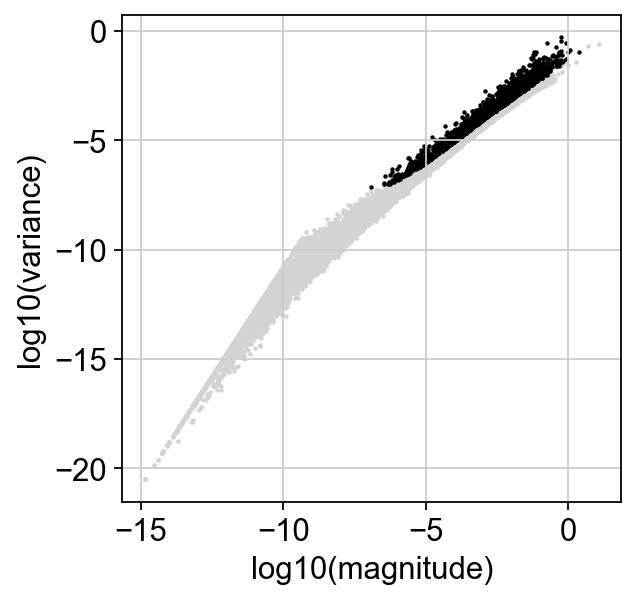

In [9]:
sc.set_figure_params()
import scFates as scf
sc.pp.filter_genes(adata,min_cells=1)
sc.pp.normalize_total(adata, target_sum=1e3)
sc.pp.log1p(adata)
scf.pp.find_overdispersed(adata,plot=True,)
adata.layers["scaled"]=sc.pp.scale(adata.X,max_value=10,copy=True)
adata.obsm["X_pca"]=sc.pp.pca(adata[:,adata.var.highly_variable].layers["scaled"])
sc.pp.neighbors(adata,n_neighbors=200,n_pcs=50,metric="cosine")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


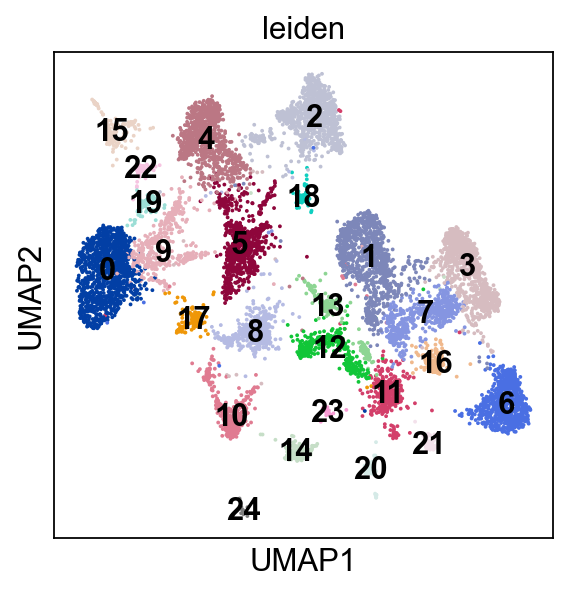

In [10]:
sc.tl.umap(adata)
sc.tl.leiden(adata)
sc.pl.umap(adata,color=["leiden"],legend_loc="on data")

In [11]:
adata.obsm["X_pca"].shape

(10142, 50)

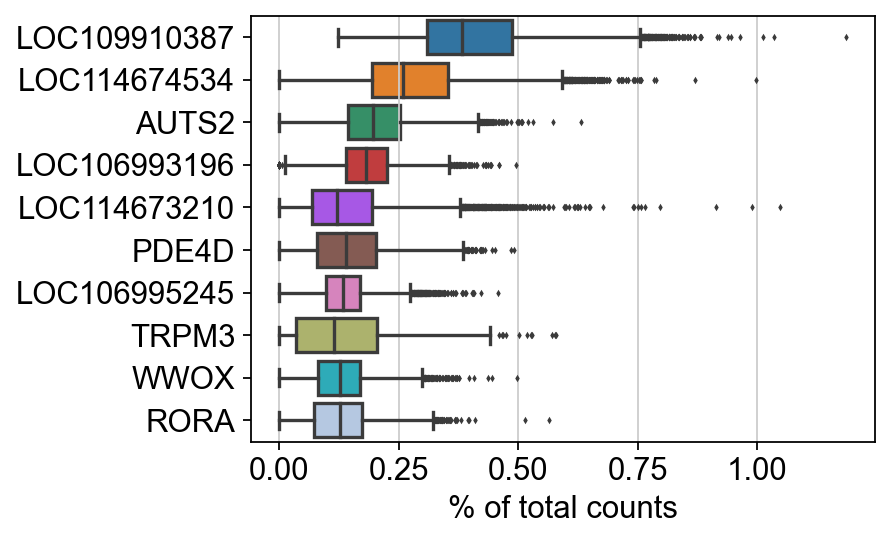

In [12]:
sc.pl.highest_expr_genes(adata, n_top=10, )

In [15]:
adata.var['MT'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['MT'], percent_top=None, log1p=False, inplace=True)

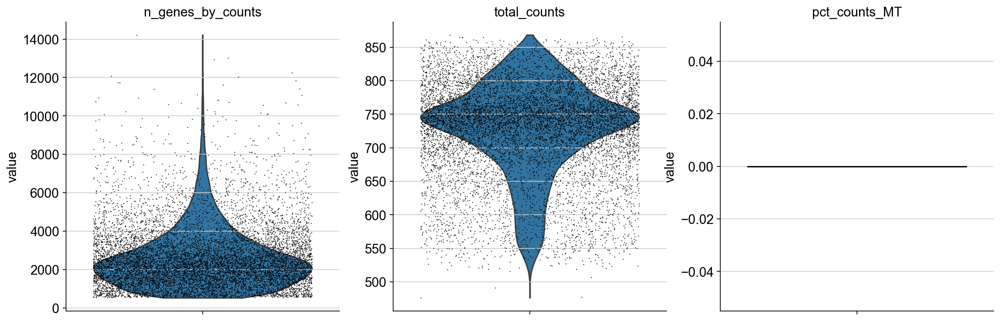

In [16]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_MT'],
             jitter=0.4, multi_panel=True)

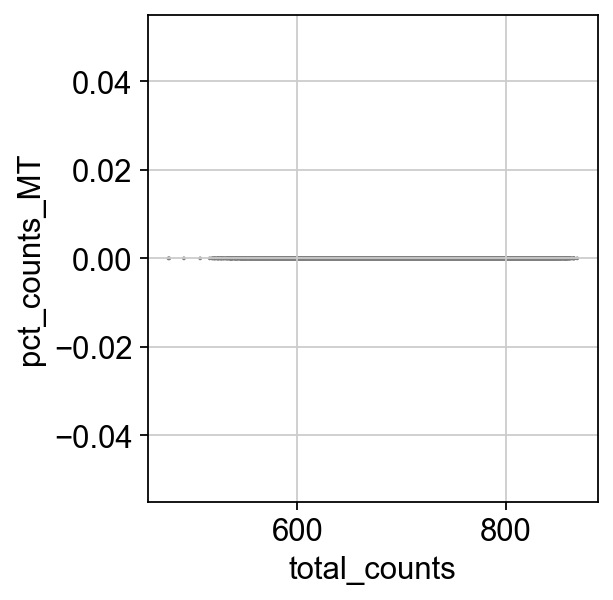

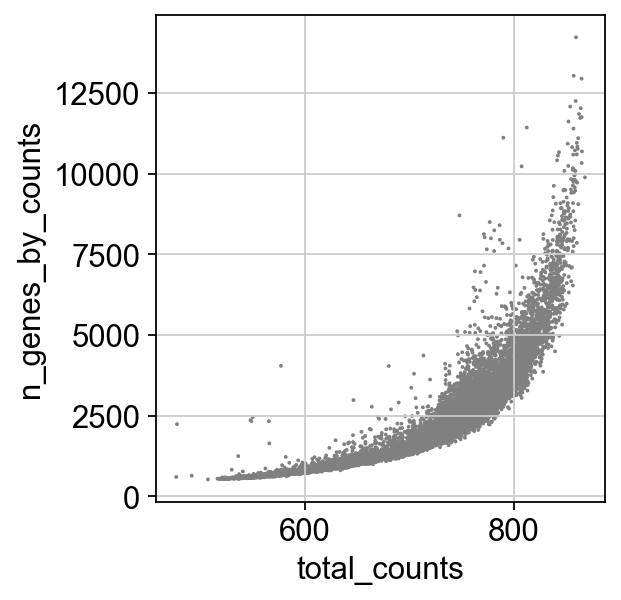

In [18]:
sc.pl.scatter(adata, x='total_counts', y='pct_counts_MT')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [19]:
adata = adata[adata.obs.n_genes_by_counts < 5000, :]
adata = adata[adata.obs.total_counts > 500, :]

In [20]:
adata

View of AnnData object with n_obs × n_vars = 9350 × 27397
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_Hb', 'pct_counts_Hb', 'total_counts_MT', 'pct_counts_MT'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'Hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'MT'
    uns: 'log1p', 'neighbors', 'umap', 'leiden', 'leiden_colors'
    obsm: 'X_pca', 'X_umap'
    layers: 'scaled'
    obsp: 'distances', 'connectivities'

In [21]:
sc.pp.normalize_total(adata, target_sum=1e4)

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\preprocessing\_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [22]:
sc.pp.log1p(adata)

In [23]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

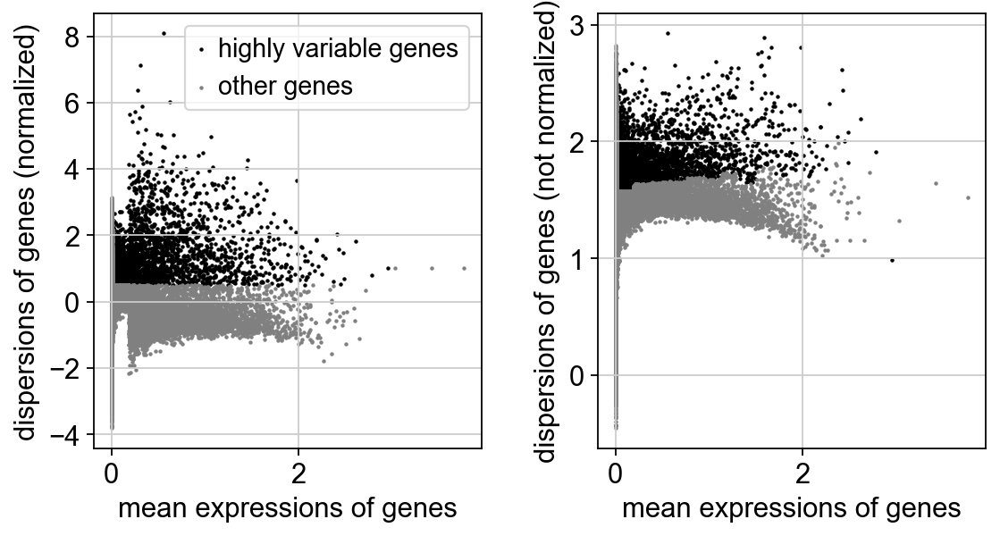

In [24]:
sc.pl.highly_variable_genes(adata)

In [25]:
adata.raw = adata

In [26]:
adata = adata[:, adata.var.highly_variable]

In [27]:
adata

View of AnnData object with n_obs × n_vars = 9350 × 5208
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_Hb', 'pct_counts_Hb', 'total_counts_MT', 'pct_counts_MT'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'Hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'MT', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'hvg'
    obsm: 'X_pca', 'X_umap'
    layers: 'scaled'
    obsp: 'distances', 'connectivities'

In [28]:
sc.pp.regress_out(adata, ['total_counts'])

In [29]:
sc.pp.scale(adata, max_value=10)

In [30]:
sc.tl.pca(adata, svd_solver='arpack',n_comps=100)

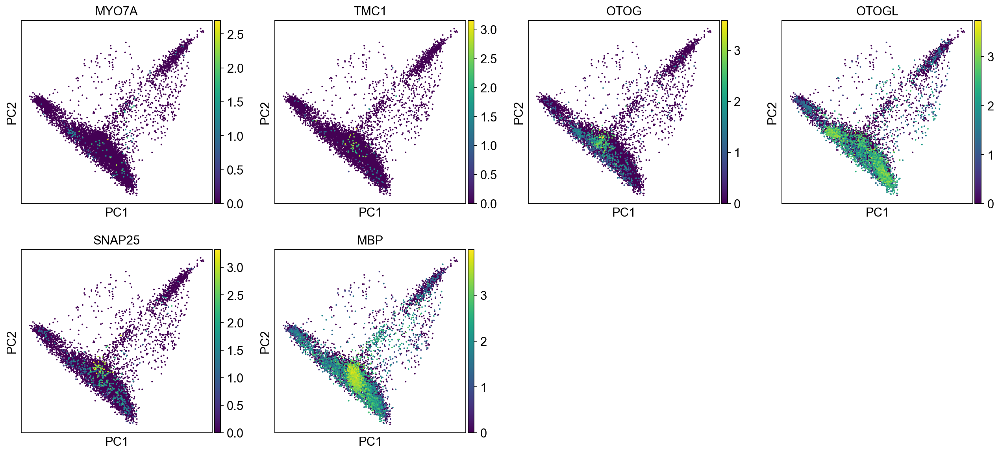

In [31]:
sc.pl.pca(adata, color=['MYO7A','TMC1','OTOG','OTOGL','SNAP25','MBP' ]                   )

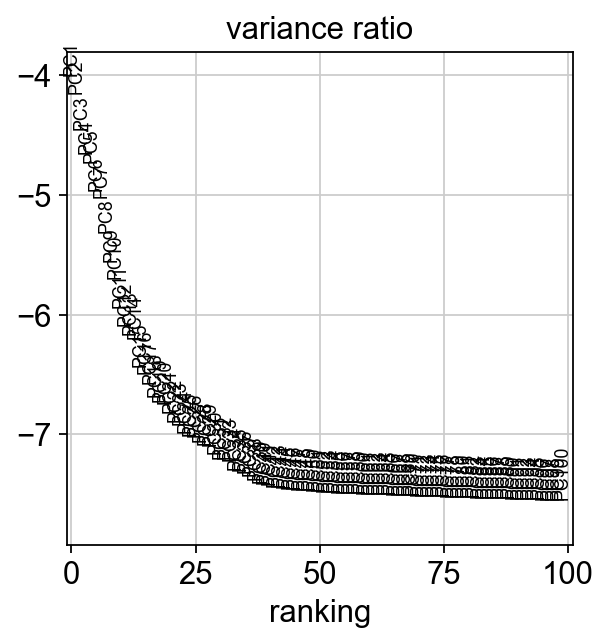

In [32]:
sc.pl.pca_variance_ratio(adata, log=True,n_pcs=100)

In [33]:
adata.write("macaque_cochlea_11y.h5ad")

In [34]:
adata

AnnData object with n_obs × n_vars = 9350 × 5208
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_Hb', 'pct_counts_Hb', 'total_counts_MT', 'pct_counts_MT'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'Hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'MT', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'hvg', 'pca'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'distances', 'connectivities'

In [35]:
sc.pp.neighbors(adata, n_neighbors=50, n_pcs=100)
sc.tl.leiden(adata,resolution=2)
sc.tl.louvain(adata)

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


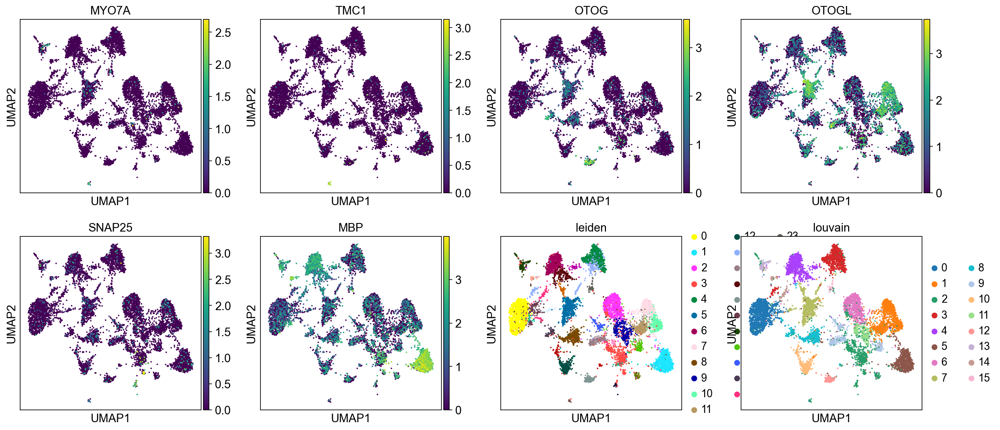

In [36]:
sc.pl.umap(adata, color=['MYO7A','TMC1','OTOG','OTOGL','SNAP25','MBP','leiden','louvain'])

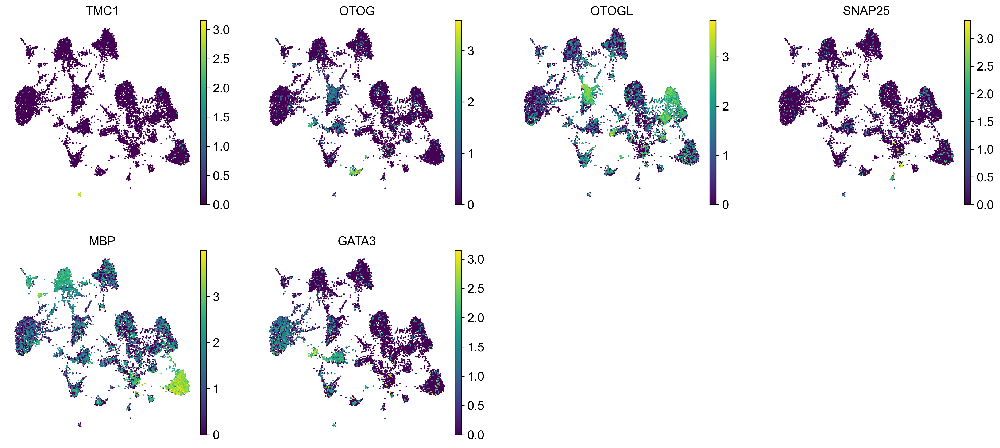

In [53]:
sc.pl.umap(adata, color=['TMC1','OTOG','OTOGL','SNAP25','MBP','GATA3'])

In [39]:
adata.write("macaque_cochlea_11y.h5ad")

In [42]:
import scanpy as sc
import scFates as scf
sc.set_figure_params()
macaque_cochlea_11y=sc.read("macaque_cochlea_11y.h5ad")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


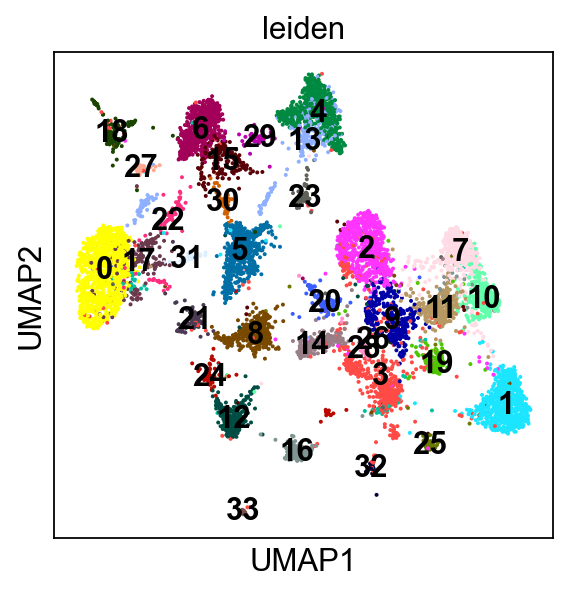

In [40]:
sc.pl.umap(adata, color=['leiden'],legend_loc="on data")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


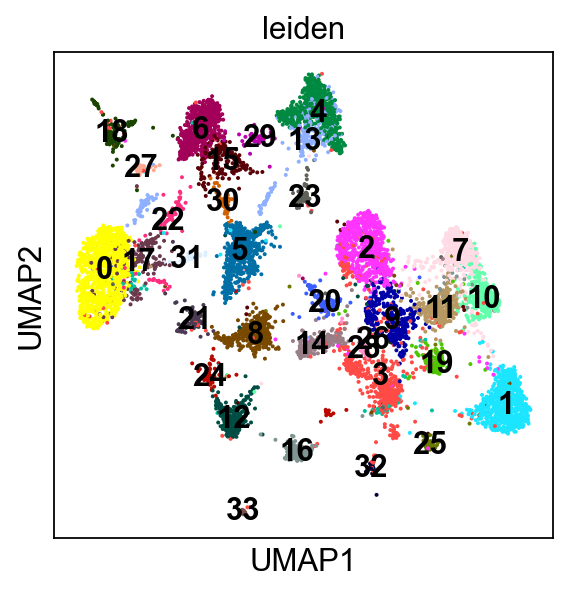

In [43]:
sc.pl.umap(macaque_cochlea_11y, color=['leiden'],legend_loc="on data")

In [47]:
marker_genes = [
    *["OTOA"], #INTERDENTAL CELLS
    *["TMC1","MYO7A","OTOF","SLC26A5","SLC17A8"],#HAIR CELLS
    *["OTOG","OTOGL","USH1C","GATA3","LGR5"],# SUPPORTING CELLS
    *["SMPX","LGR6","ENAH","NGFR","PROX1"],#PILLAR CELLS
    *["PRDM12","FGFR3"],#PILLAR CELLS, DEITERS' CELLS
    *["CEACAM16","RBP7","FABP3","S100A1"],#DEITERS' CELLS
    *["AQP4","SLC1A3","APOE"],#INNER BOR.-PH./HENSEN'S CELLS
    *["EPYC"],#INNER BOR.-PH./HENSEN'S CELLS; CLAUD./IN.-OUT.SULCUS CELLS 
    *["EMILIN2","NOTUM","RARRES1"], #TYMPANIC BORDER CELLS
    
    *["SNAP25","NEFL","PVALB","TH","ANO2"],#SGN
    *["OLIG1"], #GLIAL PRECURSOR CELLS
    *["MAG","MOG","MOBP"],#SATELLITE GLIAL CELLS
    *["MPZ","PRX"], #SCHWANN CELLS
    *["MLANA"], #LW
    *["VWF"], #ENDO.CELLS
    *["ESAM"],#ENDO.CELLS
    *["RGS5","ITGA8","CREB5"],#PERICYTES
    *["TAGLN"],#SMOOTH MUSCLE CELLS (ALDN1A2)
    *["KCNE1","ESRRB","DCLK1"],#MARGINAL CELLS
    *["TYR","DCT"],#INTER.STRIA CELLS
    *["CLDN11","ATP6V0A4","TJP1"],#BASAL STRIA CELLS
    *["SLC26A4","ANXA1"],#SPINDLE CELLS; ROOT CELLS

    
    *["OTOS","COL9A2","COL9A3","ATP2B2","SLC13A3","SLC7A11","SLC4A10","VEPH1","CHST9","THSD4"],#FIBROCYTES
    *["SLC12A2","GJB2"],# FIBROCYTES SUBTYPES I TO V
    *["DLX5","BGLAP","PHEX","IBSP"], #OSTEOBLASTS
    *["OSR2","BMP6","SLC7A11"], # SURROUNDING STRUCTURES
    *["SLC26A7"], #RM
    
    #*["RHD"], #ERYTHROCYTES
    #*["LY6G"], #NEUTROPHILS
    *["CD19"], # B CELLS
    *["CD3G"], #T CELLS   
    *["NKG7"],  #NK CELLS
    *["CD68"], #MONOCYTES
    *["AIF1","CD163"],#MACROPHAGES 
    #*["PRSS34"]  #MAST CELLS 
  
]

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


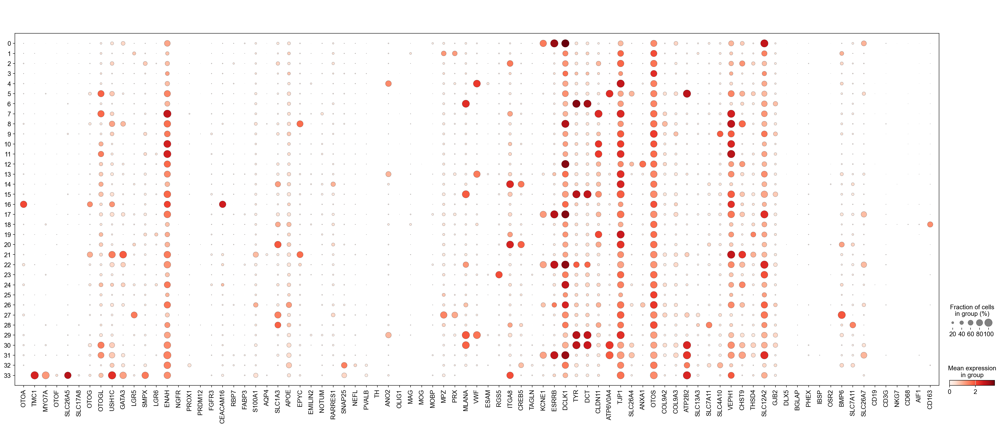

In [48]:
sc.pl.dotplot(macaque_cochlea_11y, marker_genes, groupby="leiden");

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


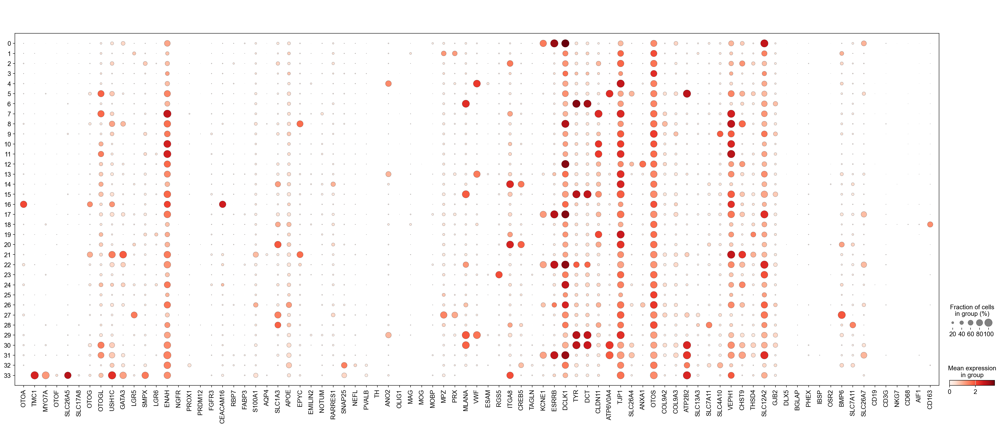

In [49]:
sc.pl.dotplot(adata, marker_genes, groupby="leiden");

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


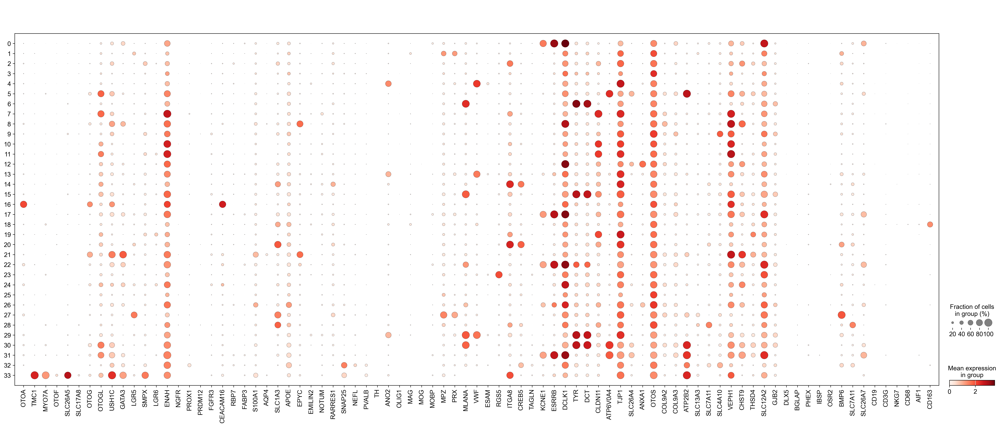

In [50]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(adata, marker_genes, groupby="leiden",
              save="11Y.pdf");




In [54]:
adata

AnnData object with n_obs × n_vars = 9350 × 5208
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_Hb', 'pct_counts_Hb', 'total_counts_MT', 'pct_counts_MT', 'louvain'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'Hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'MT', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'hvg', 'pca', 'louvain', 'louvain_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'distances', 'connectivities'

In [55]:
macaque_cochlea_11y

AnnData object with n_obs × n_vars = 9350 × 5208
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_Hb', 'pct_counts_Hb', 'total_counts_MT', 'pct_counts_MT', 'louvain'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'Hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'MT', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

In [154]:
macaque_11y_clean=adata.obs.leiden.isin([])

In [155]:
macaque_11y_clean

AAACCCAAGCAATTCC-1     True
AAACCCAAGCGAGTAC-1    False
AAACCCAAGTATGCAA-1     True
AAACCCACAAGTTCGT-1     True
AAACCCACAATCTGCA-1    False
                      ...  
TTTGTTGGTAGGACCA-1     True
TTTGTTGGTGACACAG-1     True
TTTGTTGGTGCCGAAA-1     True
TTTGTTGGTTATGTGC-1     True
TTTGTTGTCGTAGTGT-1    False
Name: leiden, Length: 9596, dtype: bool

In [59]:
adata_sub = adata[adata.obs['leiden'].isin(['0','1','4','5','6','8','9','12','13','15','16','17','18','21','22','23',
                                            '24','27','28','29','30','31','32','33'
    
])]


In [60]:
macaque_cochlea_11y_sub = macaque_cochlea_11y[macaque_cochlea_11y.obs['leiden'].isin(['0','1','4','5','6','8','9','12','13','15','16','17','18','21','22','23',
                                            '24','27','28','29','30','31','32','33'])]

In [61]:
adata_sub

View of AnnData object with n_obs × n_vars = 6226 × 5208
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_Hb', 'pct_counts_Hb', 'total_counts_MT', 'pct_counts_MT', 'louvain'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'Hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'MT', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'hvg', 'pca', 'louvain', 'louvain_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'distances', 'connectivities'

In [63]:
macaque_cochlea_11y_sub

View of AnnData object with n_obs × n_vars = 6226 × 5208
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_Hb', 'pct_counts_Hb', 'total_counts_MT', 'pct_counts_MT', 'louvain'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'Hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'MT', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


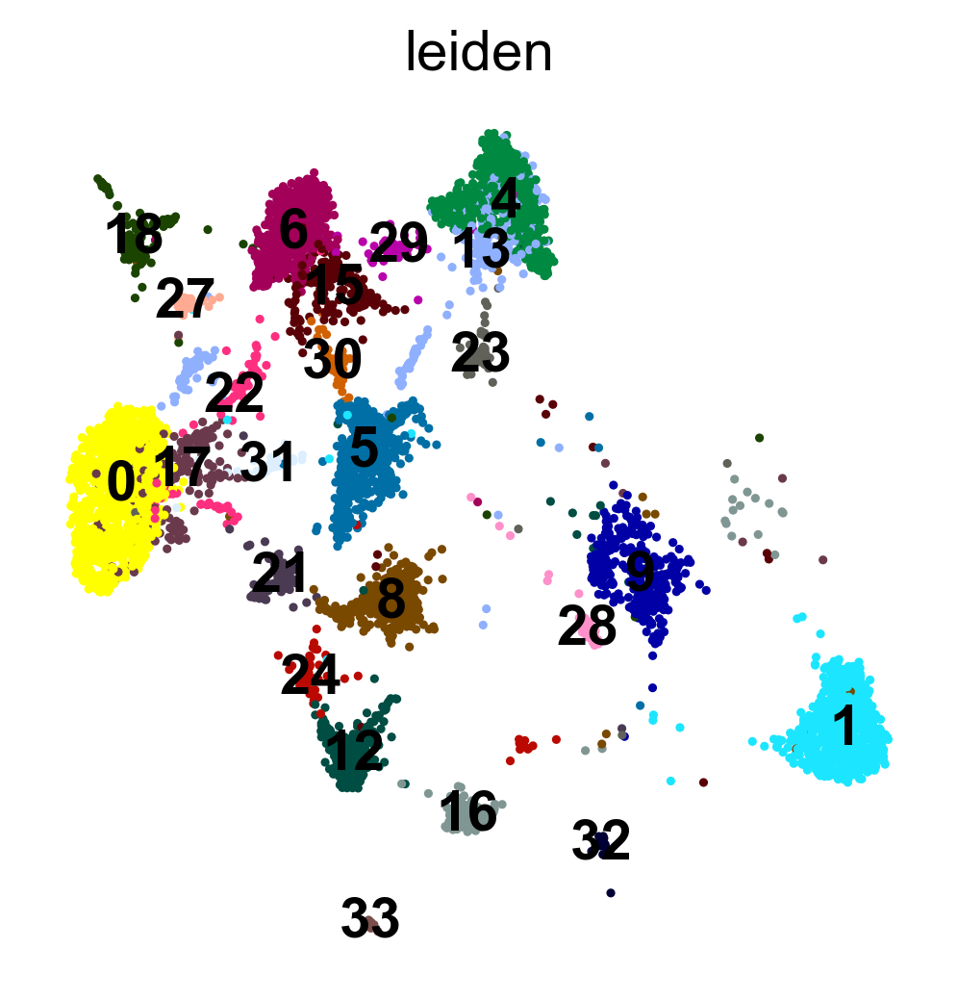

In [64]:
sc.pl.umap(adata_sub, color=['leiden'],legend_loc="on data")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


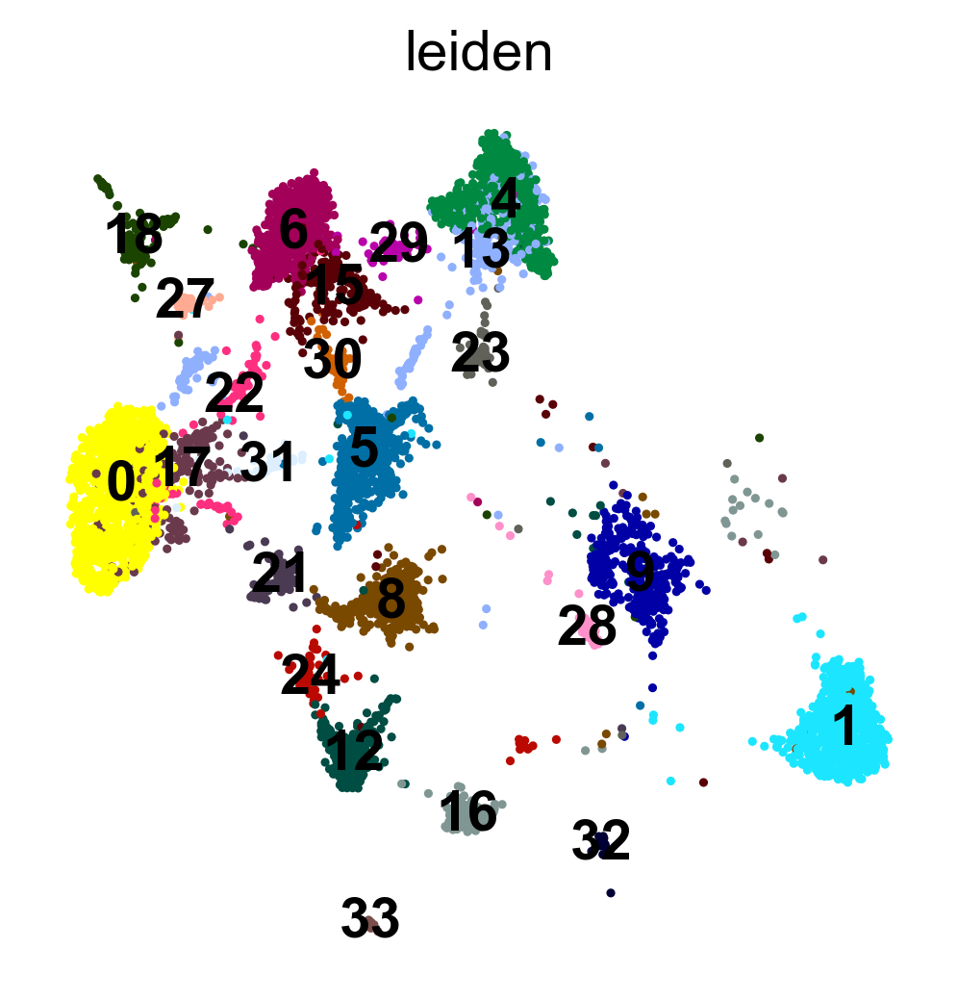

In [65]:
sc.pl.umap(macaque_cochlea_11y_sub, color=['leiden'],legend_loc="on data")

In [66]:
adata_sub

View of AnnData object with n_obs × n_vars = 6226 × 5208
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_Hb', 'pct_counts_Hb', 'total_counts_MT', 'pct_counts_MT', 'louvain'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'Hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'MT', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'hvg', 'pca', 'louvain', 'louvain_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'distances', 'connectivities'

In [67]:
adata_sub.obs["cluster"]=adata_sub.obs["leiden"]

C:\Users\Dell\AppData\Local\Temp\ipykernel_12956\812584109.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_sub.obs["cluster"]=adata_sub.obs["leiden"]


In [69]:
macaque_cochlea_11y_sub.obs["cluster"]=macaque_cochlea_11y_sub.obs["leiden"]

C:\Users\Dell\AppData\Local\Temp\ipykernel_12956\4225021017.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  macaque_cochlea_11y_sub.obs["cluster"]=macaque_cochlea_11y_sub.obs["leiden"]


G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


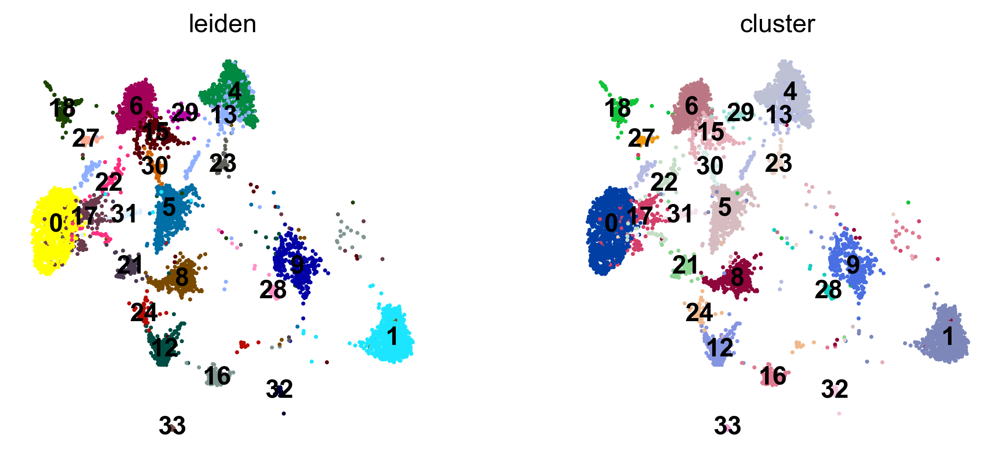

In [70]:
sc.pl.umap(adata_sub,color=["leiden","cluster"],legend_loc="on data")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


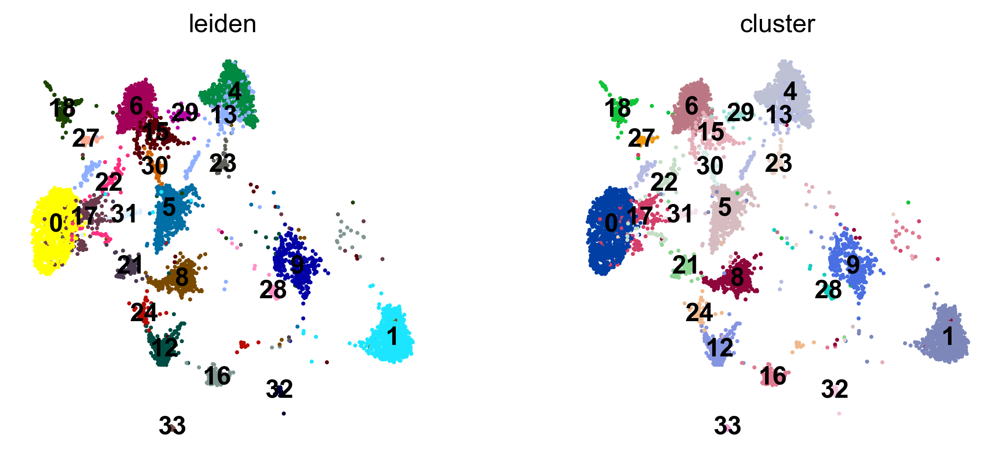

In [71]:
sc.pl.umap(macaque_cochlea_11y_sub,color=["leiden","cluster"],legend_loc="on data")

In [72]:
sc.pp.neighbors(adata_sub, n_neighbors=50, n_pcs=50)
sc.tl.leiden(adata_sub)

In [73]:
sc.pp.neighbors(macaque_cochlea_11y_sub, n_neighbors=50, n_pcs=50)
sc.tl.leiden(macaque_cochlea_11y_sub)

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


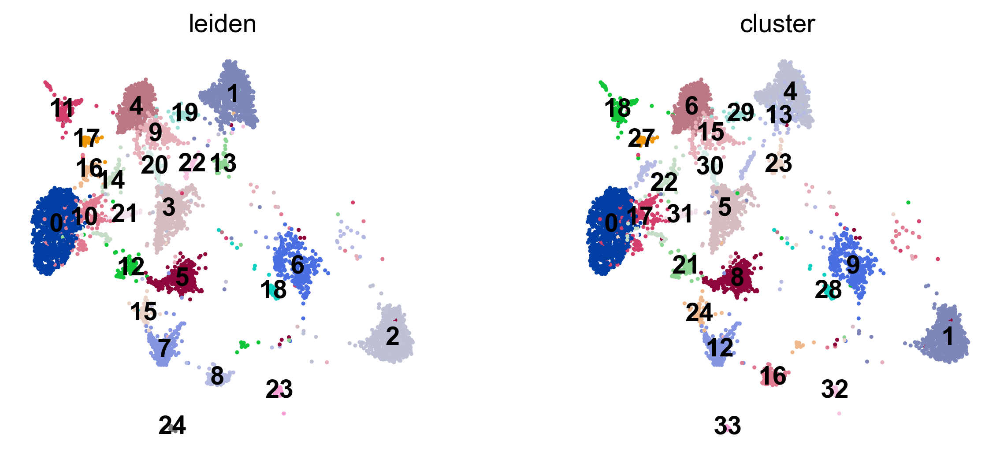

In [74]:
sc.pl.umap(adata_sub,color=["leiden","cluster"],legend_loc="on data")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


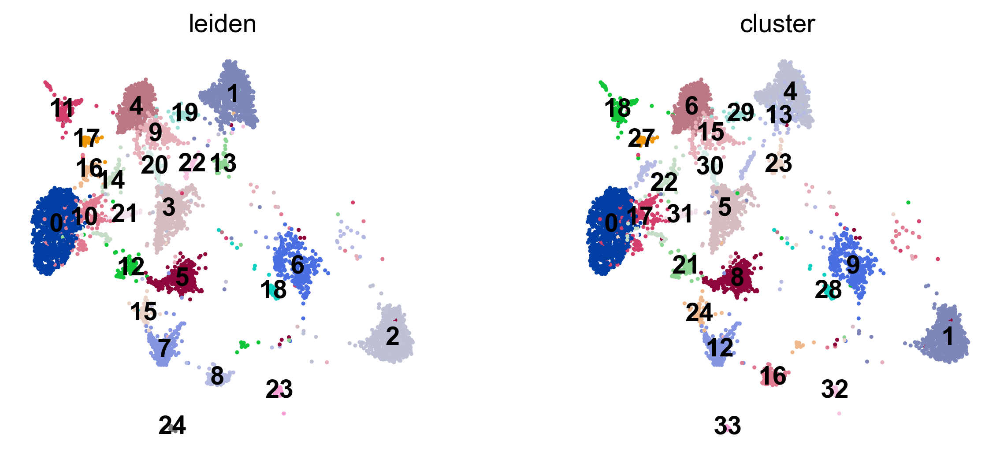

In [75]:
sc.pl.umap(macaque_cochlea_11y_sub,color=["leiden","cluster"],legend_loc="on data")

In [123]:
adata_sub.layers["scaled"]=sc.pp.scale(adata_sub.X,max_value=10,copy=True)
adata_sub.obsm["X_pca"]=sc.pp.pca(adata_sub[:,adata_sub.var.highly_variable].layers["scaled"])
sc.pp.neighbors(adata_sub,n_neighbors=50,n_pcs=50,metric="cosine")
sc.tl.umap(adata_sub)
sc.tl.leiden(adata_sub,resolution=2,key_added='cluster2')

In [124]:
macaque_cochlea_11y_sub.layers["scaled"]=sc.pp.scale(macaque_cochlea_11y_sub.X,max_value=10,copy=True)
macaque_cochlea_11y_sub.obsm["X_pca"]=sc.pp.pca(macaque_cochlea_11y_sub[:,macaque_cochlea_11y_sub.var.highly_variable].layers["scaled"])
sc.pp.neighbors(macaque_cochlea_11y_sub,n_neighbors=50,n_pcs=50,metric="cosine")
sc.tl.umap(macaque_cochlea_11y_sub)
sc.tl.leiden(macaque_cochlea_11y_sub,resolution=2,key_added='cluster2')

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


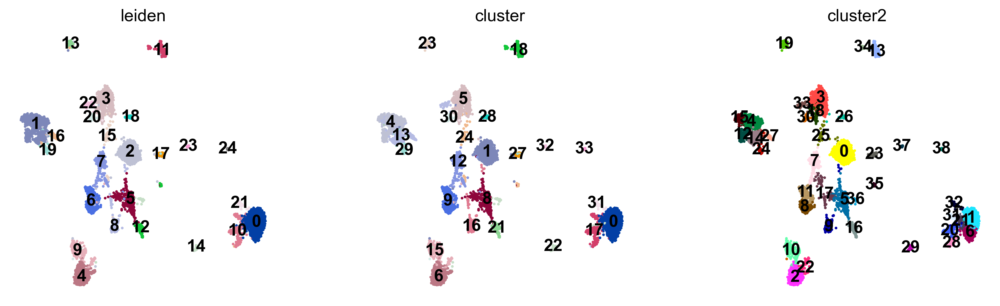

In [125]:
sc.pl.umap(adata_sub,color=["leiden","cluster",'cluster2'],legend_loc="on data")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


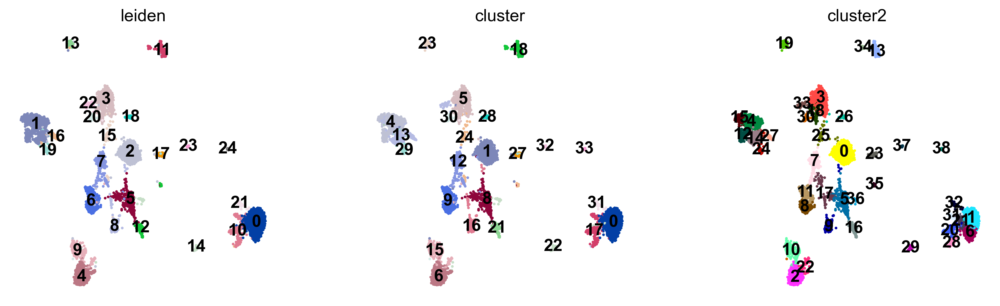

In [126]:
sc.pl.umap(macaque_cochlea_11y_sub,color=["leiden","cluster",'cluster2'],legend_loc="on data")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


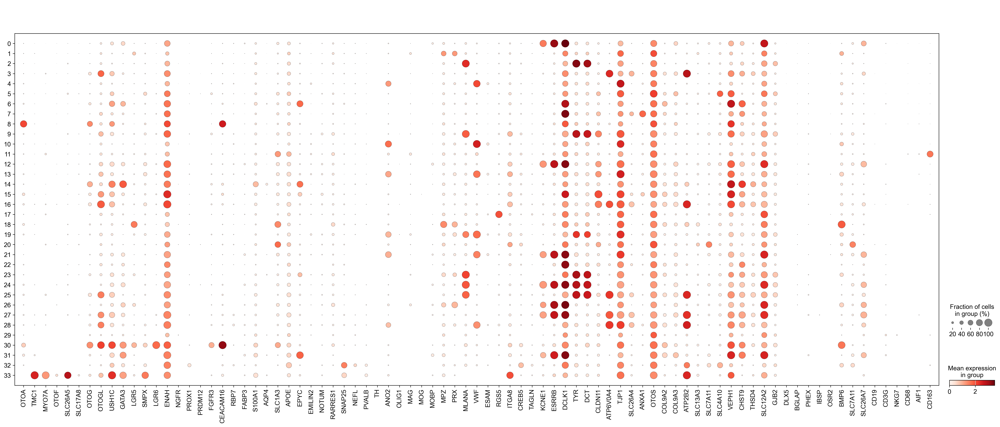

In [83]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(adata_sub, marker_genes, groupby="cluster2",
              save="new_recluster_11y.pdf");


G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


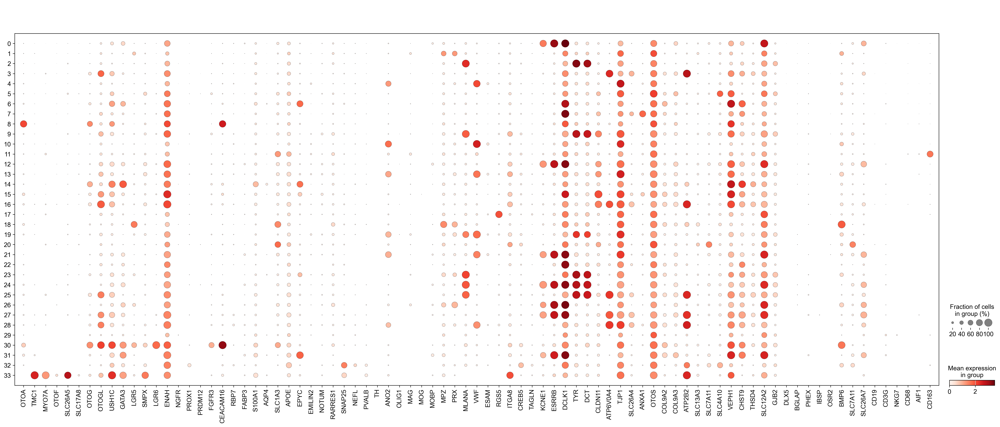

In [82]:
sc.pl.dotplot(macaque_cochlea_11y_sub, marker_genes, groupby="cluster2"
              );

In [97]:
adata_sub2= adata_sub[adata_sub.obs['cluster2'].isin(['0','1','2','3','4','5','6','7','8','9','10','11','13','14','17','18',
                                                      '19','20','22','23','28','30','31','32','33'
    
])]

In [98]:
macaque_cochlea_11y_sub2= macaque_cochlea_11y_sub[macaque_cochlea_11y_sub.obs['cluster2'].isin(['0','1','2','3','4','5','6','7','8','9','10','11','13','14','17','18',
                                                      '19','20','22','23','28','30','31','32','33'])]

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


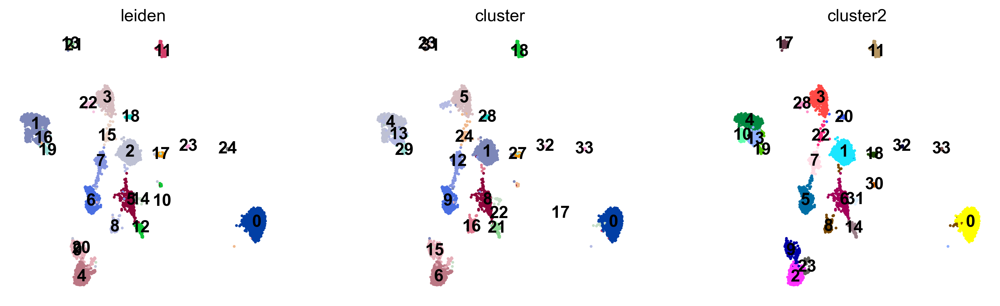

In [99]:
sc.pl.umap(adata_sub2,color=["leiden","cluster",'cluster2'],legend_loc="on data")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\tools\_dendrogram.py:161: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = dat


G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


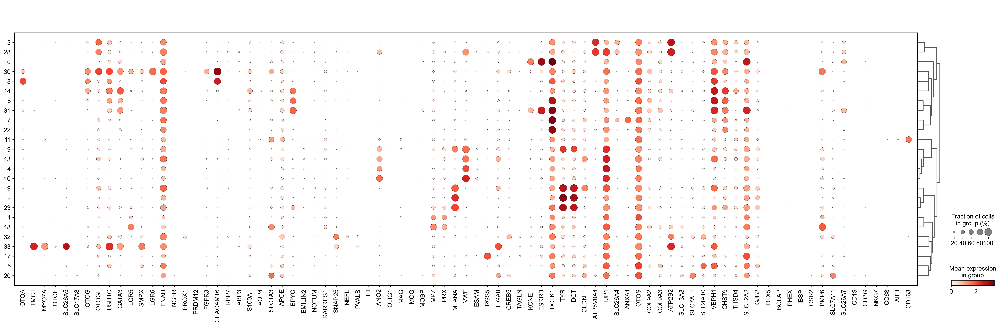

In [100]:
sc.pl.dotplot(adata_sub2, marker_genes, groupby="cluster2",
             dendrogram=True,save="new_recluster_11y.pdf")

In [137]:
adata_sub2.layers["scaled"]=sc.pp.scale(adata_sub2.X,max_value=10,copy=True)
adata_sub2.obsm["X_pca"]=sc.pp.pca(adata_sub2[:,adata_sub2.var.highly_variable].layers["scaled"])
sc.pp.neighbors(adata_sub2,n_neighbors=50,n_pcs=30,metric="cosine")
sc.tl.umap(adata_sub2)
sc.tl.leiden(adata_sub2,resolution=1.2,key_added='cluster3')

In [138]:
macaque_cochlea_11y_sub2.layers["scaled"]=sc.pp.scale(macaque_cochlea_11y_sub2.X,max_value=10,copy=True)
macaque_cochlea_11y_sub2.obsm["X_pca"]=sc.pp.pca(macaque_cochlea_11y_sub2[:,macaque_cochlea_11y_sub2.var.highly_variable].layers["scaled"])
sc.pp.neighbors(macaque_cochlea_11y_sub2,n_neighbors=50,n_pcs=30,metric="cosine")
sc.tl.umap(macaque_cochlea_11y_sub2)
sc.tl.leiden(macaque_cochlea_11y_sub2,resolution=1.2,key_added='cluster3')

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


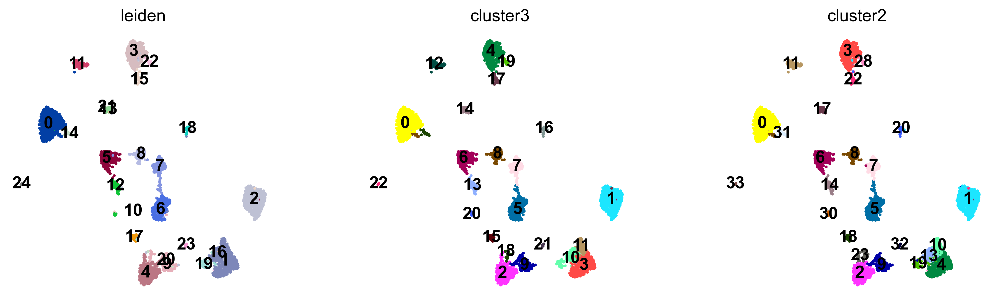

In [141]:
sc.pl.umap(adata_sub2,color=["leiden","cluster3",'cluster2'],legend_loc="on data")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


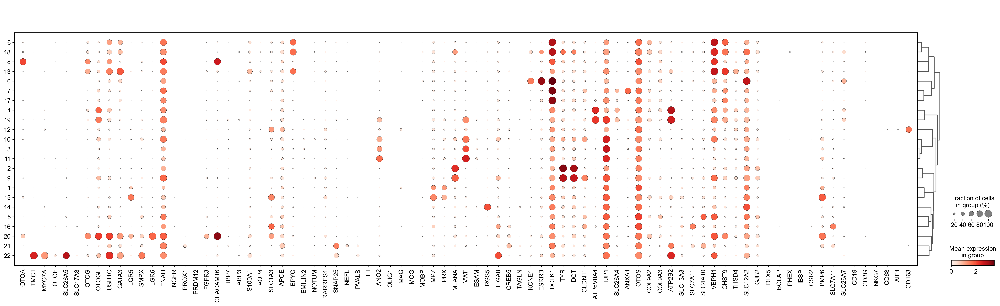

In [143]:
sc.tl.dendrogram(adata_sub2,groupby='cluster3')
sc.pl.dotplot(adata_sub2, marker_genes, groupby="cluster3",
             dendrogram=True,save="new_recluster_11y-2.pdf")

In [172]:
cluster_annotation = {
    '0': '10.Ms',
    '1': '12.Schwann.Cells',
    '2': '9.Is',
    '3': '4.Endo.Cell',
    '4': '1.Bs',
    '5': '5.Fb',
    '6': '2.CC_ISC_OSC',
    '7': '13.Sp/Rt',
    '8': '8.IDC',
    '9': '9.Is',
    '10': '4.Endo.Cell',
    '11': '4.Endo.Cell',
    '12': '14.macrophages',
    '13': '7.IBC_IPh_HeC',
    '14': '15.pericytes',
    '15': '12.Schwann.Cells',
    '16': '5.Fb',
    '17': '1.Bs',
    '18': '9.Is',
    '19': '1.Bs',
    '20': '3.DC_PC',
    '21': '11.SGN',
    '22': '6.HC',
}
adata_sub2.obs['cell_type2'] = adata_sub2.obs['cluster3'].map(cluster_annotation).astype('category')


In [173]:
macaque_cochlea_11y_sub2.obs['cell_type2'] = macaque_cochlea_11y_sub2.obs['cluster3'].map(cluster_annotation).astype('category')

In [174]:
adata_sub2.obs['cluster3']

AAACCCAAGCACACCC-1     0
AAACCCACACACGGTC-1    12
AAACCCACATTGACTG-1     4
AAACCCAGTTGCTCCT-1     0
AAACCCATCCGTAATG-1     1
                      ..
TTTGTTGCAGTCACGC-1    11
TTTGTTGGTGCCTATA-1     0
TTTGTTGGTGGTTTAC-1     3
TTTGTTGTCCGATCTC-1     3
TTTGTTGTCTGTCAGA-1    10
Name: cluster3, Length: 5661, dtype: category
Categories (23, object): ['0', '1', '2', '3', ..., '19', '20', '21', '22']

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


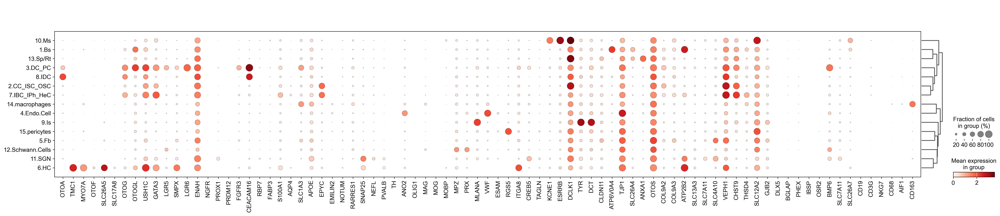

In [179]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.tl.dendrogram(macaque_cochlea_11y_sub2,groupby='cell_type2')
sc.pl.dotplot(macaque_cochlea_11y_sub2, marker_genes, groupby="cell_type2",
             dendrogram=True,save="cochlea-cell_type_macaque_11y_raw.pdf")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


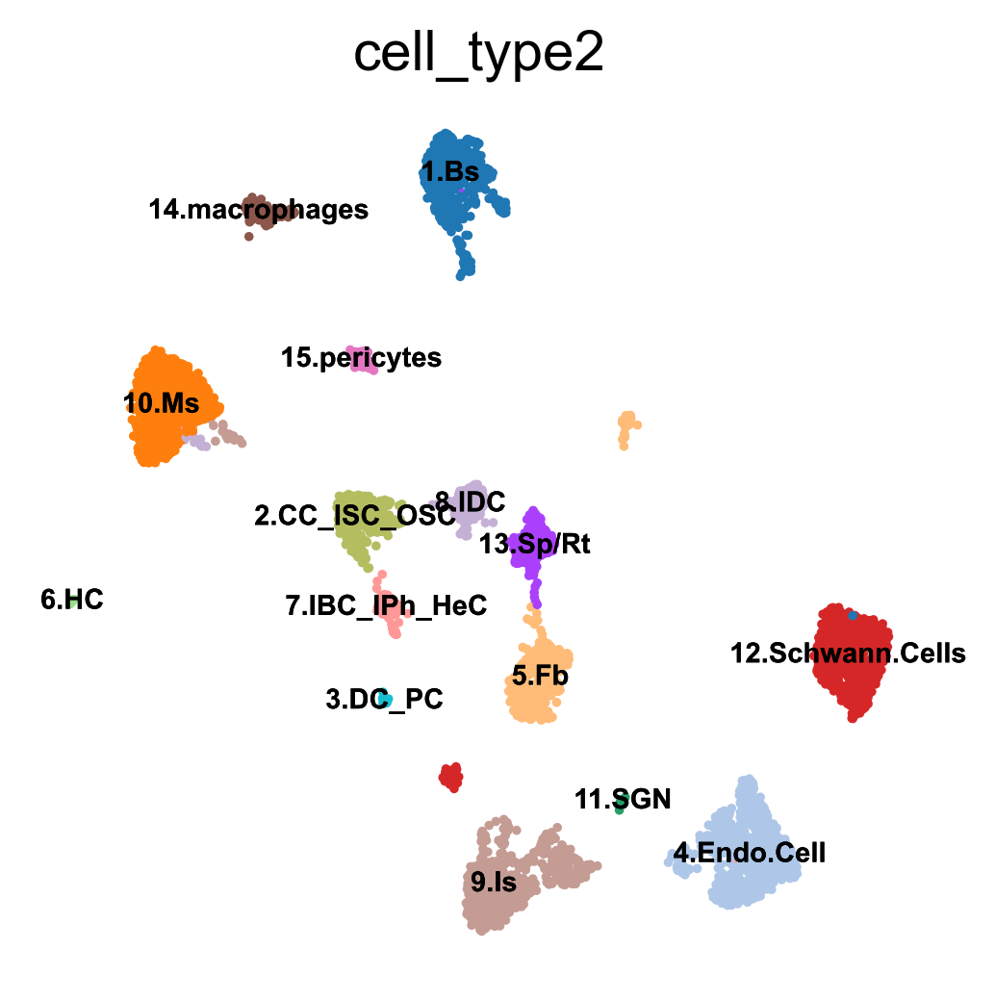

In [177]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(macaque_cochlea_11y_sub2,color='cell_type2',legend_loc='on data',frameon=False, legend_fontsize=7, legend_fontoutline=False,
          save="macaque_11y-2.pdf")

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


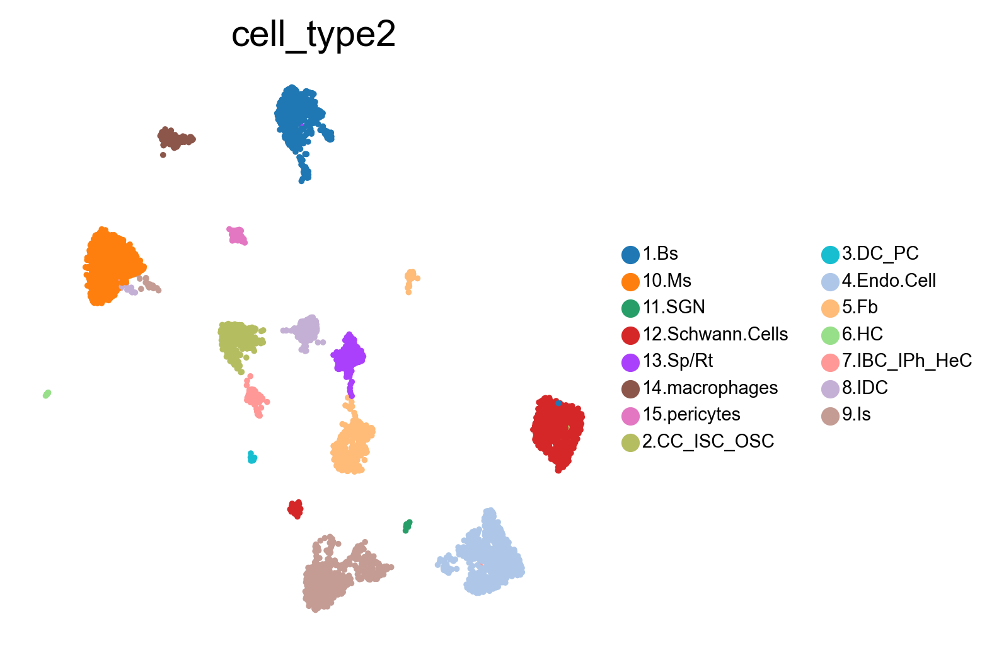

In [178]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(macaque_cochlea_11y_sub2,color='cell_type2',frameon=False, legend_fontsize=7, legend_fontoutline=False,
          save="macaque_11y.pdf")

In [152]:
macaque_cochlea_11y_sub2.write("macaque_cochlea_11y_cell-type-annotation.h5ad")

In [188]:
marker_genes_refined = [
    *["OTOA"], #INTERDENTAL CELLS
    *["TMC1","MYO7A","OTOF","SLC26A5","SLC17A8","CALB1"],#HAIR CELLS
    *["OTOG","OTOGL","USH1C","GATA3","LGR5"],# SUPPORTING CELLS
    *["SMPX","LGR6","ENAH","PROX1"],#PILLAR CELLS
    *["FGFR3"],#PILLAR CELLS, DEITERS' CELLS
    *["CEACAM16","S100A1"],#DEITERS' CELLS
    *["SLC1A3","APOE"],#INNER BOR.-PH./HENSEN'S CELLS
    *["EPYC"],#INNER BOR.-PH./HENSEN'S CELLS; CLAUD./IN.-OUT.SULCUS CELLS 
    *["EMILIN2","NOTUM","RARRES1"], #TYMPANIC BORDER CELLS
    
    *["SNAP25","NEFL","PVALB","PRPH","ANO2",'CALB2'],#SGN
    #*["OLIG1","OLIG2"], #GLIAL PRECURSOR CELLS
    #*["MAG","MOG","MOBP"],#SATELLITE GLIAL CELLS
    *["MPZ","PRX",'MBP'], #SCHWANN CELLS
    *["MLANA"], #LW
    *["VWF"], #ENDO.CELLS
    *["ESAM"],#ENDO.CELLS
    *["RGS5","ITGA8","CREB5"],#PERICYTES
    #*["TAGLN"],#SMOOTH MUSCLE CELLS (ALDN1A2)
    *["KCNE1","ESRRB","DCLK1"],#MARGINAL CELLS
    *["TYR","DCT"],#INTER.STRIA CELLS
    *["CLDN11","ATP6V0A4","TJP1"],#BASAL STRIA CELLS
    *["SLC26A4","ANXA1"],#SPINDLE CELLS; ROOT CELLS

    
    *["OTOS","COL9A2","COL9A3","ATP2B2","SLC13A3","SLC7A11","SLC4A10","VEPH1","CHST9","THSD4"],#FIBROCYTES
    *["SLC12A2","GJB2"],# FIBROCYTES SUBTYPES I TO V
    #*["DLX5","BGLAP","PHEX", "DMP1","IBSP"], #OSTEOBLASTS
    *["BMP6","SLC7A11"], # SURROUNDING STRUCTURES
    *["SLC26A7"], #RM
    
    #*["RHD"], #ERYTHROCYTES
    #*["LY6G"], #NEUTROPHILS
   # *["CD19"], # B CELLS
    #*["CD3G"], #T CELLS   
   # *["NKG7"],  #NK CELLS
   # *["CD68"], #MONOCYTES
    *["AIF1","CD163"],#MACROPHAGES 
    #*["PRSS34"]  #MAST CELLS 

    
]

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


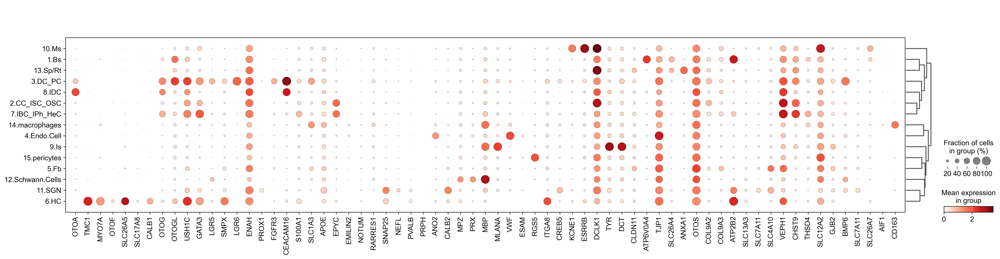

In [189]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(macaque_cochlea_11y_sub2, marker_genes_refined, groupby="cell_type2",
             dendrogram=True,save="cochlea-cell_type_refined_macaque_11y.pdf")

In [157]:
macaque_cochlea_11y_sub2

AnnData object with n_obs × n_vars = 5661 × 5208
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_Hb', 'pct_counts_Hb', 'total_counts_MT', 'pct_counts_MT', 'louvain', 'cluster', 'cluster2', 'cluster3', 'cell_type'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'Hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'MT', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'umap', 'cluster_colors', 'cluster2_colors', 'dendrogram_cell_type', 'cell_type_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

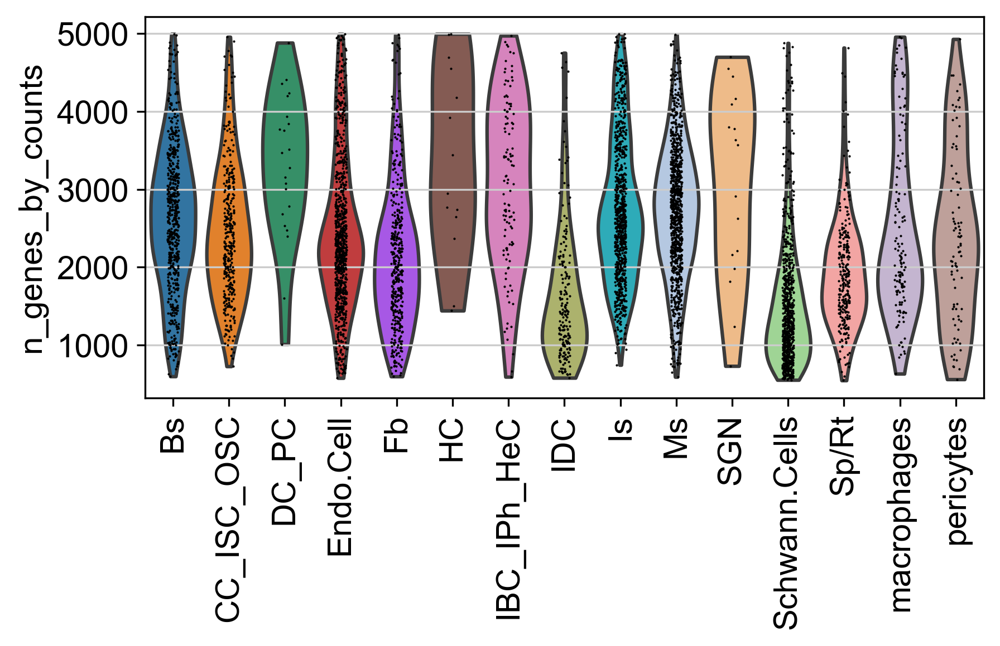

In [158]:
sc.set_figure_params(figsize=(6,3),frameon=False,dpi=150,dpi_save=600)
sc.pl.violin(macaque_cochlea_11y_sub2, ['n_genes_by_counts'], groupby='cell_type',rotation=90)

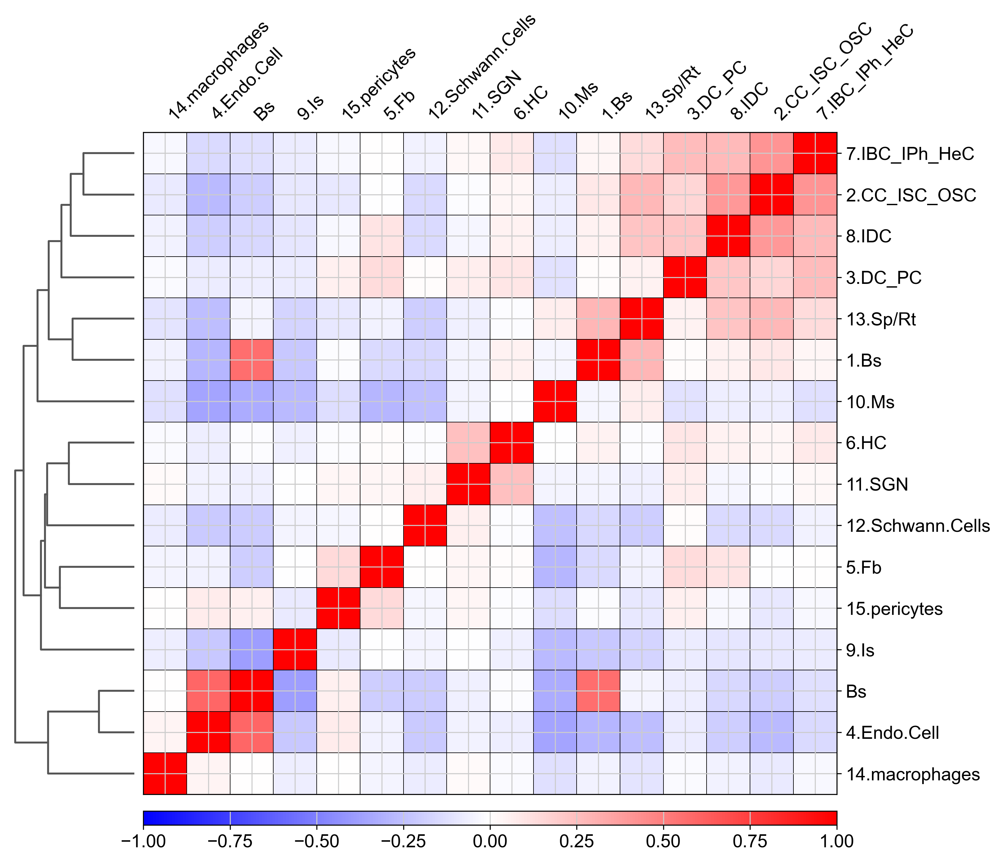

In [169]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.correlation_matrix(macaque_cochlea_11y_sub2, 'cell_type2',
                         save="cell-type-correlation_macaque_11y.pdf")

In [160]:
macaque_cochlea_11y_sub2

AnnData object with n_obs × n_vars = 5661 × 5208
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_Hb', 'pct_counts_Hb', 'total_counts_MT', 'pct_counts_MT', 'louvain', 'cluster', 'cluster2', 'cluster3', 'cell_type'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'Hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'MT', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'umap', 'cluster_colors', 'cluster2_colors', 'dendrogram_cell_type', 'cell_type_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

In [180]:
cluster_annotation3 = {
    '0': 'Lateral wall (LW)',
    '1': 'Glia cells (GCs)',
    '2': 'Lateral wall (LW)',
    '3': 'Lateral wall (LW)',
    '4': 'Lateral wall (LW)',
    '5': 'Lateral wall (LW)',
    '6': 'Supporting cells (SCs)',
    '7': 'Lateral wall (LW)',
    '8': 'Supporting cells (SCs)',
    '9': 'Lateral wall (LW)',
    '10': 'Lateral wall (LW)',
    '11': 'Lateral wall (LW)',
    '12': 'macrophages',
    '13': 'Supporting cells (SCs)',
    '14': 'Lateral wall (LW)',
    '15': 'Glia cells (GCs)',
    '16': 'Lateral wall (LW)',
    '17': 'Lateral wall (LW)',
    '18': 'Lateral wall (LW)',
    '19': 'Lateral wall (LW)',
    '20': 'Supporting cells (SCs)',
    '21': 'Neurons (Neu)',
    '22': 'Hair cells (HCs)',
}

In [183]:
macaque_cochlea_11y_sub2.obs['cell_type3'] = macaque_cochlea_11y_sub2.obs['cluster3'].map(cluster_annotation3).astype('category')

G:\Miniconda3\envs\scFates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


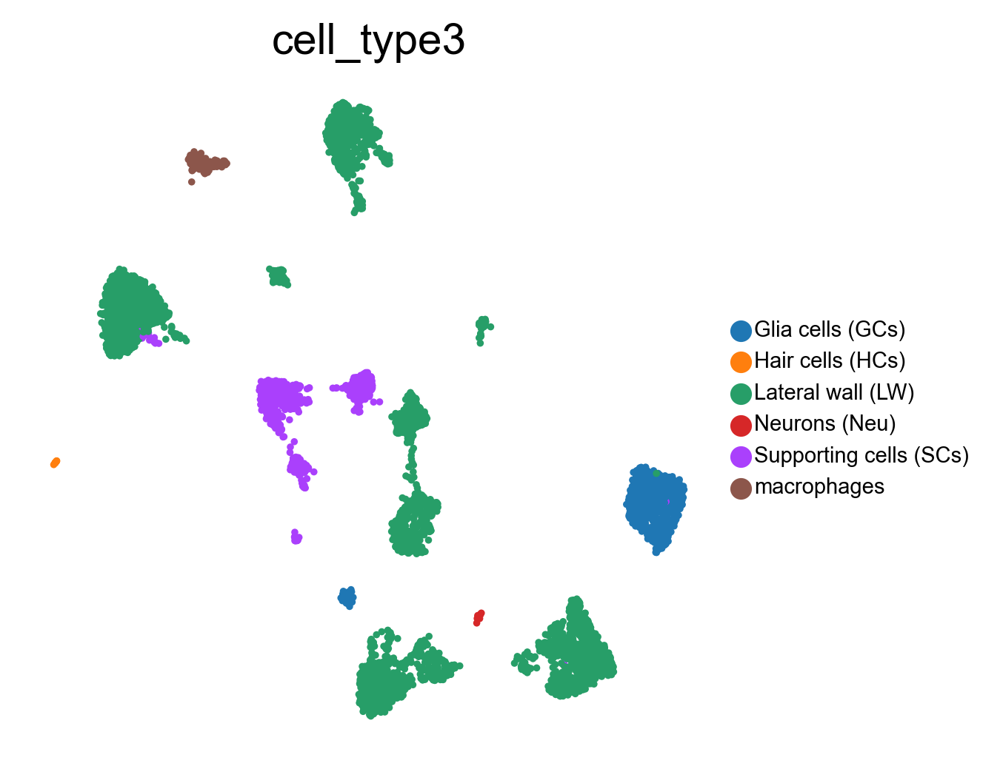

In [184]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(macaque_cochlea_11y_sub2,color='cell_type3',frameon=False, legend_fontsize=7, legend_fontoutline=False,
          save="macaque_11y_regions.pdf")

In [190]:
macaque_cochlea_11y_sub2

AnnData object with n_obs × n_vars = 5661 × 5208
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_Hb', 'pct_counts_Hb', 'total_counts_MT', 'pct_counts_MT', 'louvain', 'cluster', 'cluster2', 'cluster3', 'cell_type', 'cell_type2', 'cell_type3'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'Hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'MT', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'umap', 'cluster_colors', 'cluster2_colors', 'dendrogram_cell_type', 'cell_type_colors', 'dendrogram_cell_type2', 'cell_type2_colors', 'cell_type3_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

In [191]:
macaque_11y_raw=macaque_cochlea_11y_sub2

In [192]:
macaque_11y_raw

AnnData object with n_obs × n_vars = 5661 × 5208
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_Hb', 'pct_counts_Hb', 'total_counts_MT', 'pct_counts_MT', 'louvain', 'cluster', 'cluster2', 'cluster3', 'cell_type', 'cell_type2', 'cell_type3'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'Hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'MT', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'umap', 'cluster_colors', 'cluster2_colors', 'dendrogram_cell_type', 'cell_type_colors', 'dendrogram_cell_type2', 'cell_type2_colors', 'cell_type3_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

In [193]:
macaque_11y_raw.raw.to_adata()

AnnData object with n_obs × n_vars = 5661 × 27397
    obs: 'CellID', 'leiden', 'n_genes_by_counts', 'total_counts', 'total_counts_Hb', 'pct_counts_Hb', 'total_counts_MT', 'pct_counts_MT', 'louvain', 'cluster', 'cluster2', 'cluster3', 'cell_type', 'cell_type2', 'cell_type3'
    var: 'gene_ids', 'feature_types', 'genome', 'Gene', 'n_cells', 'm', 'v', 'n_obs', 'res', 'lp', 'lpa', 'qv', 'highly_variable', 'Hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'MT', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'umap', 'cluster_colors', 'cluster2_colors', 'dendrogram_cell_type', 'cell_type_colors', 'dendrogram_cell_type2', 'cell_type2_colors', 'cell_type3_colors'
    obsm: 'X_pca', 'X_umap'
    obsp: 'connectivities', 'distances'

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


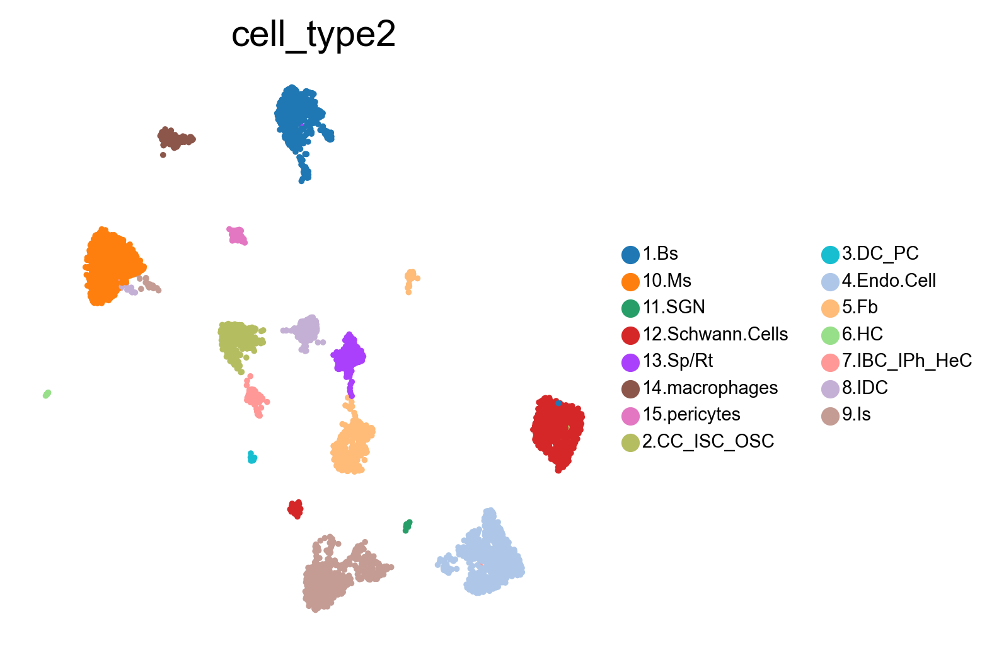

In [6]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(macaque_cochlea_11y_new,color='cell_type2',frameon=False, legend_fontsize=7, legend_fontoutline=False
          )

In [195]:
macaque_11y_raw.write("macaque_11y_raw.h5ad")

In [4]:
import scanpy as sc
#import scFates as scf
sc.set_figure_params()
macaque_cochlea_11y_new=sc.read("macaque_11y_raw.h5ad")

In [5]:
marker_genes_refined = [
    *["OTOA"], #INTERDENTAL CELLS
    *["TMC1","MYO7A","OTOF","SLC26A5","SLC17A8","CALB1"],#HAIR CELLS
    *["OTOG","OTOGL","USH1C","GATA3","LGR5"],# SUPPORTING CELLS
    *["SMPX","LGR6","ENAH","PROX1"],#PILLAR CELLS
    *["FGFR3"],#PILLAR CELLS, DEITERS' CELLS
    *["CEACAM16","S100A1"],#DEITERS' CELLS
    *["SLC1A3","APOE"],#INNER BOR.-PH./HENSEN'S CELLS
    *["EPYC"],#INNER BOR.-PH./HENSEN'S CELLS; CLAUD./IN.-OUT.SULCUS CELLS 
    *["EMILIN2","NOTUM","RARRES1"], #TYMPANIC BORDER CELLS
    
    *["SNAP25","NEFL","PVALB","PRPH","ANO2",'CALB2'],#SGN
    #*["OLIG1","OLIG2"], #GLIAL PRECURSOR CELLS
    #*["MAG","MOG","MOBP"],#SATELLITE GLIAL CELLS
    *["MPZ","PRX",'MBP'], #SCHWANN CELLS
    *["MLANA"], #LW
    *["VWF"], #ENDO.CELLS
    *["ESAM"],#ENDO.CELLS
    *["RGS5","ITGA8","CREB5"],#PERICYTES
    #*["TAGLN"],#SMOOTH MUSCLE CELLS (ALDN1A2)
    *["KCNE1","ESRRB","DCLK1"],#MARGINAL CELLS
    *["TYR","DCT"],#INTER.STRIA CELLS
    *["CLDN11","ATP6V0A4","TJP1"],#BASAL STRIA CELLS
    *["SLC26A4","ANXA1"],#SPINDLE CELLS; ROOT CELLS

    
    *["OTOS","COL9A2","COL9A3","ATP2B2","SLC13A3","SLC7A11","SLC4A10","VEPH1","CHST9","THSD4"],#FIBROCYTES
    *["SLC12A2","GJB2"],# FIBROCYTES SUBTYPES I TO V
    #*["DLX5","BGLAP","PHEX", "DMP1","IBSP"], #OSTEOBLASTS
    *["BMP6","SLC7A11"], # SURROUNDING STRUCTURES
    *["SLC26A7"], #RM
    
    #*["RHD"], #ERYTHROCYTES
    #*["LY6G"], #NEUTROPHILS
   # *["CD19"], # B CELLS
    #*["CD3G"], #T CELLS   
   # *["NKG7"],  #NK CELLS
   # *["CD68"], #MONOCYTES
    *["AIF1","CD163"],#MACROPHAGES 
    #*["PRSS34"]  #MAST CELLS 

    
]

G:\Miniconda3\envs\coefates\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


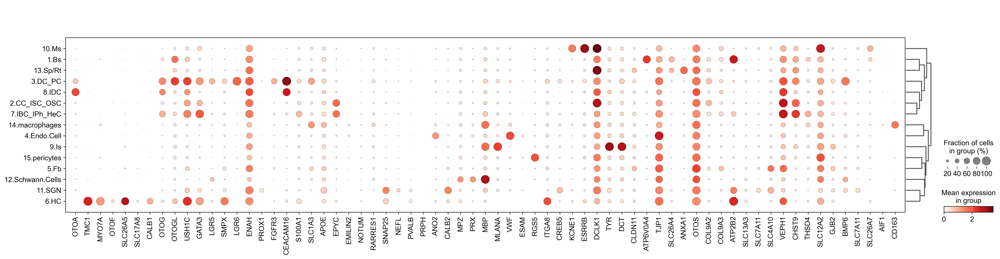

In [6]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(macaque_cochlea_11y_new, marker_genes_refined, groupby="cell_type2",
             dendrogram=True)

In [7]:
small_marker_dict={
 'OHC':['TMC1','MYO7A','SLC26A5','CALB1'],
 'IHC':['OTOF','SLC17A8'],
    'TypeI_SGN' :['SNAP25','NEFL','PVALB','CALB2'],
    'TypeII_SGN':['PRPH','ANO2'],
 'Schwann.Cells':['MPZ','PRX'],
 'Fb':['SLC13A3','SLC7A11','THSD4','SLC12A2','BMP6','SLC7A11','SLC26A7'],
'pericytes':['RGS5','ITGA8','CREB5'],
      'Is':['MLANA','TYR','DCT'],
    'Endo.Cells':['VWF','ESAM'],
     'macrophages':['AIF1','CD163'],
    'Pan_SC':['OTOG','OTOGL','USH1C','GATA3'],
 'IBC_IPh_HeC':['S100A1','SLC1A3'],
    'CC_ISC_OSC':['APOE','EPYC'],
 'IDC':['OTOA'],
 'DC':['LGR5','FGFR3','PROX1','CEACAM16'],
     'PC' :['SMPX','LGR6','ENAH'],
'Sp/Rt':['SLC26A4','ANXA1'],
    'Bs':['CLDN11','ATP6V0A4','TJP1'],
'Ms':['KCNE1','ESRRB','DCLK1'],
      
    
}
# check if the markers are in the data
smarker_genes_in_data = dict()
for ct, markers in small_marker_dict.items():
    markers_found = list()
    for marker in markers:
        if marker in macaque_cochlea_11y_new.var.index:
            markers_found.append(marker)
    smarker_genes_in_data[ct] = markers_found
#del [] # remove the last marker
del_markers = list()
for ct, markers in smarker_genes_in_data.items():
    if markers==[]:
        del_markers.append(ct)
for ct in del_markers:
    del smarker_genes_in_data[ct]

In [8]:
smarker_genes_in_data

{'OHC': ['TMC1', 'SLC26A5', 'CALB1'],
 'IHC': ['OTOF', 'SLC17A8'],
 'TypeI_SGN': ['SNAP25', 'NEFL', 'PVALB', 'CALB2'],
 'TypeII_SGN': ['ANO2'],
 'Schwann.Cells': ['MPZ', 'PRX'],
 'Fb': ['SLC13A3',
  'SLC7A11',
  'THSD4',
  'SLC12A2',
  'BMP6',
  'SLC7A11',
  'SLC26A7'],
 'pericytes': ['RGS5', 'ITGA8', 'CREB5'],
 'Is': ['MLANA', 'TYR', 'DCT'],
 'Endo.Cells': ['VWF', 'ESAM'],
 'macrophages': ['CD163'],
 'Pan_SC': ['OTOG', 'OTOGL', 'GATA3'],
 'IBC_IPh_HeC': ['S100A1', 'SLC1A3'],
 'CC_ISC_OSC': ['APOE', 'EPYC'],
 'IDC': ['OTOA'],
 'DC': ['LGR5', 'FGFR3', 'PROX1', 'CEACAM16'],
 'PC': ['SMPX', 'LGR6', 'ENAH'],
 'Sp/Rt': ['SLC26A4', 'ANXA1'],
 'Bs': ['CLDN11', 'ATP6V0A4', 'TJP1'],
 'Ms': ['KCNE1', 'ESRRB', 'DCLK1']}

categories: 1.Bs, 10.Ms, 11.SGN, etc.
var_group_labels: OHC, IHC, TypeI_SGN, etc.


G:\Miniconda3\envs\coefates\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


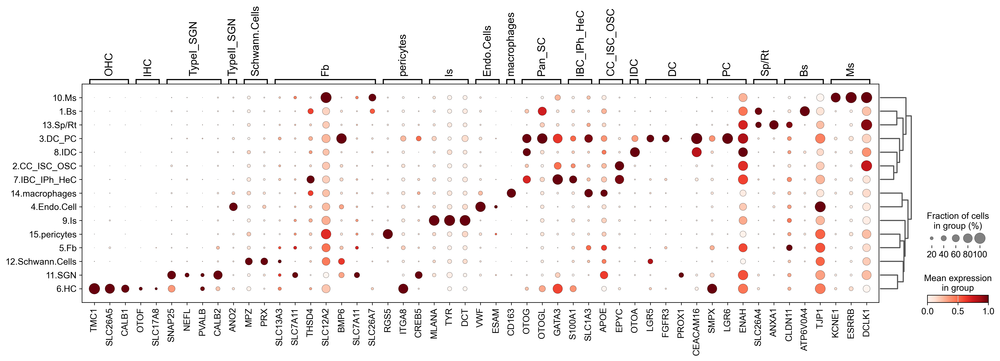

In [9]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.dotplot(
    macaque_cochlea_11y_new,
    groupby="cell_type2",
    var_names=smarker_genes_in_data,
   dendrogram=True,
    standard_scale="var",  # standard scale: normalize each gene to range from 0 to 1
    save="cochlea-cell_type_refined_macaque_11y-order.pdf"
)

G:\Miniconda3\envs\coefates\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


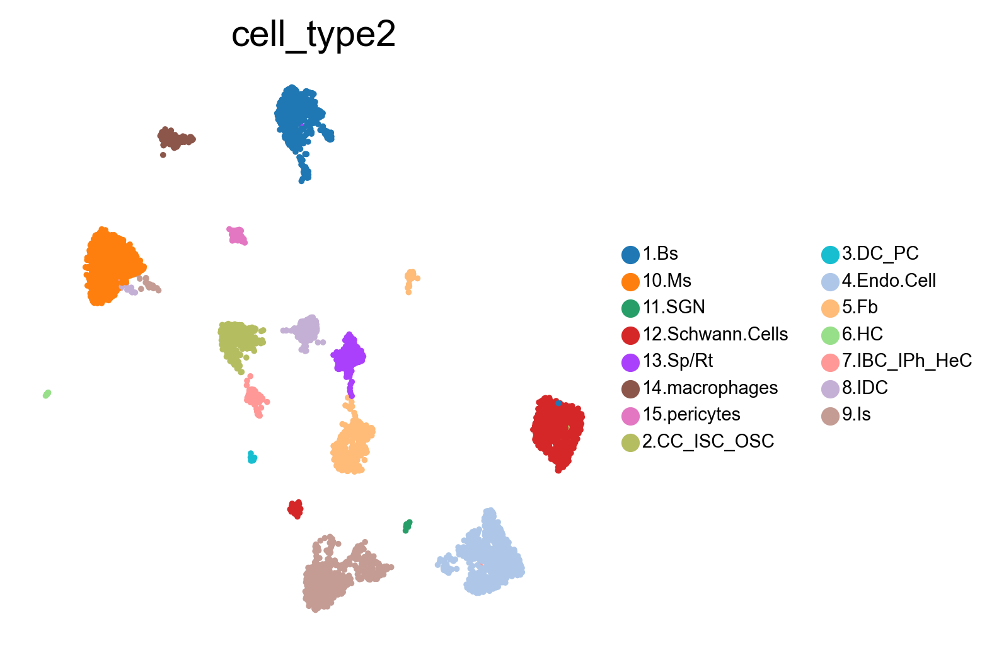

In [11]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(macaque_cochlea_11y_new,color='cell_type2',frameon=False, legend_fontsize=7, legend_fontoutline=False
          )

In [15]:
cluster_annotation3 = {
    '1.Bs': '1.Bs',
    '10.Ms': '10.Ms',
    '11.SGN': '11.SGN',
    '12.Schwann.Cells': '12.Schwann.Cells',
    '13.Sp/Rt': '13.Sp_Rt',
    '14.macrophages': '14.macrophages',
    '15.pericytes': '15.pericytes',
    '2.CC_ISC_OSC': '2.CC_ISC_OSC',
    '3.DC_PC': '3.DC_PC',
    '4.Endo.Cell': '4.Endo.Cell',
    '5.Fb': '5.Fb',
    '6.HC': '6.HC',
    '7.IBC_IPh_HeC': '7.IBC_IPh_HeC',
    '8.IDC': '8.IDC',
    '9.Is': '9.Is',
    
}
macaque_cochlea_11y_new.obs['cell_type5'] = macaque_cochlea_11y_new.obs['cell_type2'].map(cluster_annotation3).astype('category')

In [16]:
sc.tl.rank_genes_groups(macaque_cochlea_11y_new,"cell_type5",method="wilcoxon")

In [20]:
from warnings import simplefilter
# ignore all future warnings
simplefilter(action='ignore', category=FutureWarning)
import pandas as pd
writer = pd.ExcelWriter('data/COCHLEA_MACAQUE_DE_11-year.xlsx', engine='xlsxwriter')
for cl in macaque_cochlea_11y_new.obs.cell_type5.cat.categories:
    sc.get.rank_genes_groups_df(macaque_cochlea_11y_new,cl,pval_cutoff=1,log2fc_min=0).set_index("names").to_excel(writer, 
                                                                     sheet_name=cl)
    
writer.save()